# init

In [1]:
from __future__ import print_function, division
# 数値計算やデータフレーム操作に関するライブラリをインポートする
import numpy as np
import pandas as pd

# URL によるリソースへのアクセスを提供するライブラリをインポートする。
import urllib.request 

# 図やグラフを図示するためのライブラリをインポートする。
import matplotlib.pyplot as plt
%matplotlib inline

import sklearn #機械学習のライブラリ
from sklearn.decomposition import PCA #主成分分析器

In [2]:
def logistic(a, x):
  return 1.0-(a*x)*x

def next_x(f, N, x):
    x_new = np.empty(x.shape)
    ave=(eps/float(N))*np.sum(list(map(f, np.tile(r, x.size), x)))
    x_new = (1-eps)*f(r, x) + ave #この行と前列の行の違いはmapを使うかどうかで生じる.
    return x_new

# cluster

inline 
notebook違い
https://ksknw.hatenablog.com/entry/2016/08/04/233103

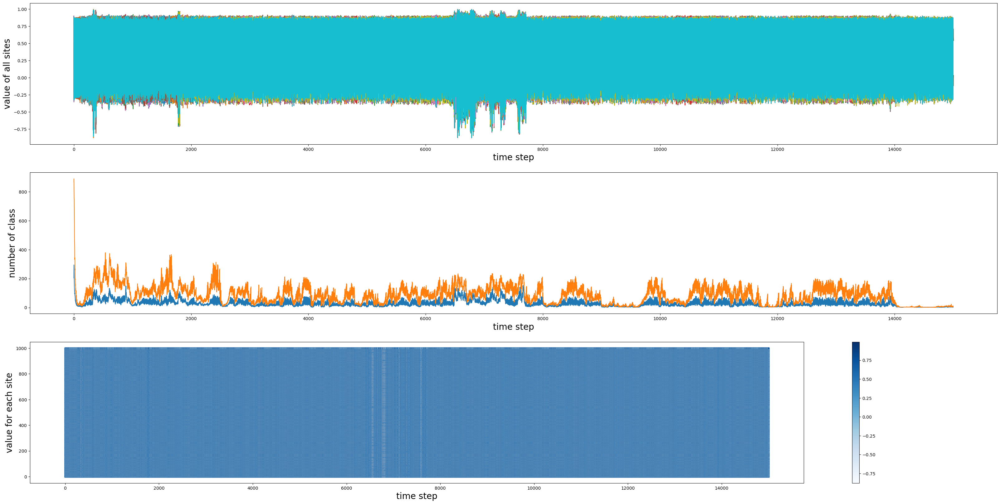

In [4]:
L = 1000      # no. of lattice sites
eps = 0.2   # diffusive coupling strength: 
r = 1.92     # control parameter r:
P1 = float(2**8) # accuracy
P2 = float(2**12)
"""
時刻 n , 精度 P クラスター数 (k_n)^P の表示
ex: 1/P=2^(-18), 2^(-12)
p150参照
"""
np.random.seed(1010)
ic = np.random.uniform(0.1, 0.9, L)  # random initial condition betn. (0,1)

nTransients = 0   # The iterates we'll throw away
nSteps = 15000       # This sets how many time steps will be described

#縦 site, 横 time(step)
states = np.empty((nSteps, L))

for i in range(nTransients):
  ic=next_x(logistic, L, ic)

states[0]=ic
class_numsP1=[]
class_numsP2=[]
for i in range(nSteps-1):
  states[i+1]=next_x(logistic, L, states[i])
  
  #clusteringP1
  clustering_list = list(map(lambda x: float(int(x*P1))/P1, states[i])) 
  """以下で異なる値の数を取り出す. ユニークな値のみを抽出.
  https://note.nkmk.me/python-list-unique-duplicate/
  """
  num=len(list(set(clustering_list)) )
  class_numsP1.append(num)

  #clusteringP2
  clustering_list = list(map(lambda x: float(int(x*P2))/P2, states[i])) 
  num=len(list(set(clustering_list)) )
  class_numsP2.append(num)

#最後だけ追加P1
clustering_list = list(map(lambda x: float(int(x*P1))/P1, states[nSteps-1])) 
num=len(list(set(clustering_list)) )
class_numsP1.append(num)

#最後だけ追加P2
clustering_list = list(map(lambda x: float(int(x*P2))/P2, states[nSteps-1])) 
num=len(list(set(clustering_list)) )
class_numsP2.append(num)


plt.rcParams["figure.figsize"] = (40, 20)#(縦, 横)

#図の作成指示
fig=plt.figure()#(figsize=(100,100))
ax1=fig.subplots(3,1)

#１つ目の図
ax1[0].set_xlabel("time step",fontsize=20)
ax1[0].set_ylabel("value of all sites",fontsize=20)  

time=np.arange(nSteps)
ax1[0].plot(time, states)

#２つ目の図 p150参照, clustering
ax1[1].set_xlabel("time step", fontsize=20)
ax1[1].set_ylabel("number of class", fontsize=20)
ax1[1].plot(time, class_numsP1)
ax1[1].plot(time, class_numsP2)

#３つ目の図
ax1[2].set_xlabel("time step",fontsize=20)
ax1[2].set_ylabel("value for each site",fontsize=20)  

for i in range(L):
  bar=ax1[2].scatter(time, np.tile(i, time.size), s=8, c=states[:,i], cmap='Blues', marker=",")
fig.colorbar(bar)

# Display plot in window
plt.show() 

# PCA 3d

主成分得点
pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(len(dfs.columns))]).head()

第1,2,3主成分をプロット

ax1=fig.subplots(1,1)
で
'AxesSubplot'
を使用する.
ここでは
'Axes3D'
ax1 = Axes3D(fig)

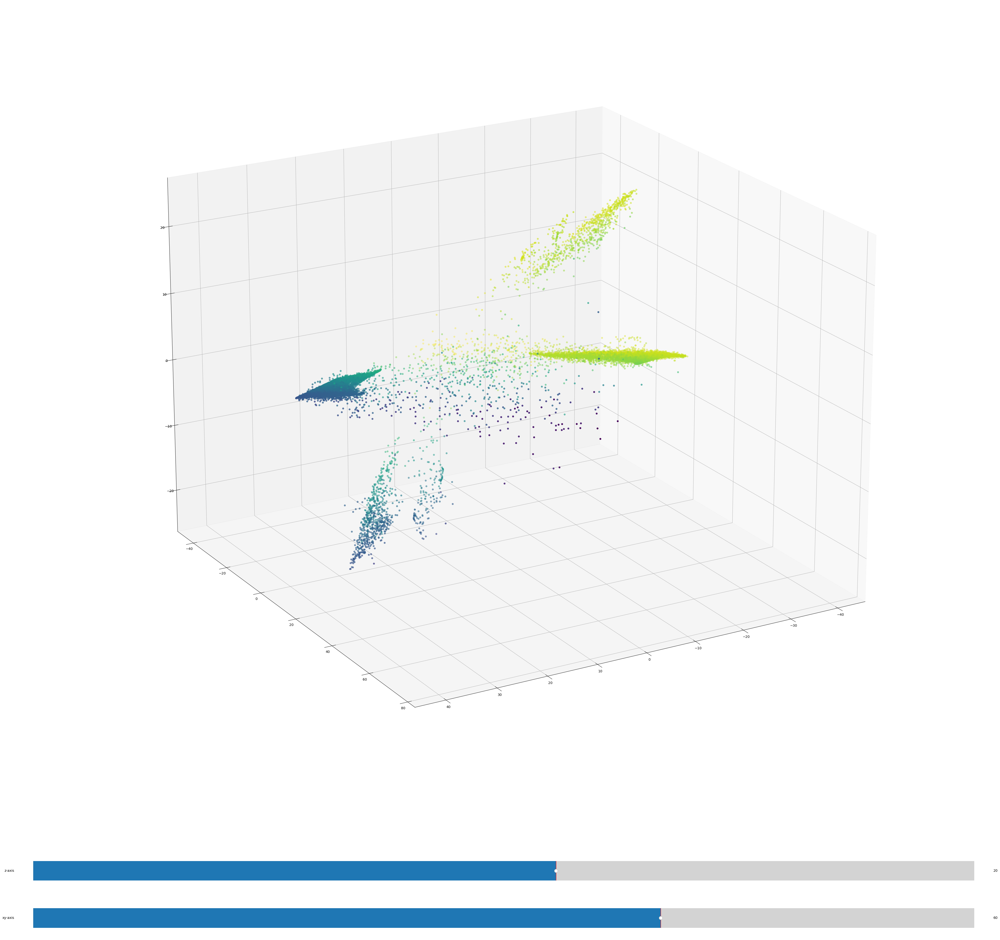

In [5]:
df=pd.DataFrame(states)
# 行列の標準化
dfs = df.iloc[:, 1:].apply(lambda x: (x-x.mean())/x.std(), axis=0)
dfs.head()

#主成分分析の実行
pca = PCA()
pca.fit(dfs)
# データを主成分空間に写像
feature = pca.transform(dfs)

#3次元プロットするためのモジュール
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.widgets import Slider

fig=plt.figure(figsize=(50,50))#(figsize=(100,100))

# Figureの中に３Dグラフ、Slider用のAxesを追加
axcolor = 'gold'
gs = fig.add_gridspec(20, 10)
ax1 = fig.add_subplot(gs[:17,:], projection='3d')
ax_slider_z = fig.add_subplot(gs[18,:], facecolor=axcolor)
ax_slider_xy = fig.add_subplot(gs[19,:], facecolor=axcolor)

# Sliderの設定
z0 = 20
xy0 = 60

delta = 10
slider_z = Slider(ax_slider_z, 'z-axis', -180, 180, valinit=z0, valstep=delta)
slider_xy = Slider(ax_slider_xy, 'xy-axis', -180, 180, valinit=xy0, valstep=delta)

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=z0, azim=xy0)

# 3Dグラフを表示
ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(df.iloc[:, 0]))

# Sliderを動かした時に呼ばれるコールバック関数
def view_change(val):
    sz = slider_z.val
    sxy = slider_xy.val
    ax1.view_init(elev=sxy, azim=sz)
    fig.canvas.draw_idle()    
"""
#図の設定
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 
ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(df.iloc[:, 0]))
"""
#plt.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(df.iloc[:, 0]))

slider_z.on_changed(view_change)
slider_xy.on_changed(view_change)
plt.show()

In [6]:
%matplotlib notebook
fig=plt.figure(figsize=(50,50))#(figsize=(100,100))

# Figureの中に３Dグラフ、Slider用のAxesを追加

axcolor = 'gold'
gs = fig.add_gridspec(20, 10)
ax1 = fig.add_subplot(gs[:17,:], projection='3d')
ax_slider_z = fig.add_subplot(gs[18,:], facecolor=axcolor)
ax_slider_xy = fig.add_subplot(gs[19,:], facecolor=axcolor)

# Sliderの設定
z0 = 20
xy0 = 60

delta = 10
slider_z = Slider(ax_slider_z, 'z-axis', -180, 180, valinit=z0, valstep=delta)
slider_xy = Slider(ax_slider_xy, 'xy-axis', -180, 180, valinit=xy0, valstep=delta)

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=z0, azim=xy0)

# 3Dグラフを表示
bar=ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(np.arange(len(feature[:,0]))))

# Sliderを動かした時に呼ばれるコールバック関数
def view_change(val):
    sz = slider_z.val
    sxy = slider_xy.val
    ax1.view_init(elev=sxy, azim=sz)
    fig.canvas.draw_idle()    

#plt.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(df.iloc[:, 0]))

slider_z.on_changed(view_change)
slider_xy.on_changed(view_change)
fig.colorbar(bar)
plt.show()

<IPython.core.display.Javascript object>

## PCA

In [7]:
df=pd.DataFrame(states)
# 行列の標準化
dfs = df.iloc[:, 1:].apply(lambda x: (x-x.mean())/x.std(), axis=0)
dfs.head()

#主成分分析の実行
pca = PCA()
pca.fit(dfs)
# データを主成分空間に写像
feature = pca.transform(dfs)
"""
# 主成分得点
pd.DataFrame(feature, columns=["PC{}".format(x + 1) for x in range(len(dfs.columns))]).head()
"""
# 第1,2,3主成分をプロット

#3次元プロットするためのモジュール
from mpl_toolkits.mplot3d import Axes3D

fig=plt.figure(figsize=(10,10))#(figsize=(100,100))
# ax1 = Axes3D(fig)
ax1=fig.add_subplot(projection='3d')
#図の設定
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 
ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(np.arange(len(feature[:, 0]))))
plt.show()

<IPython.core.display.Javascript object>

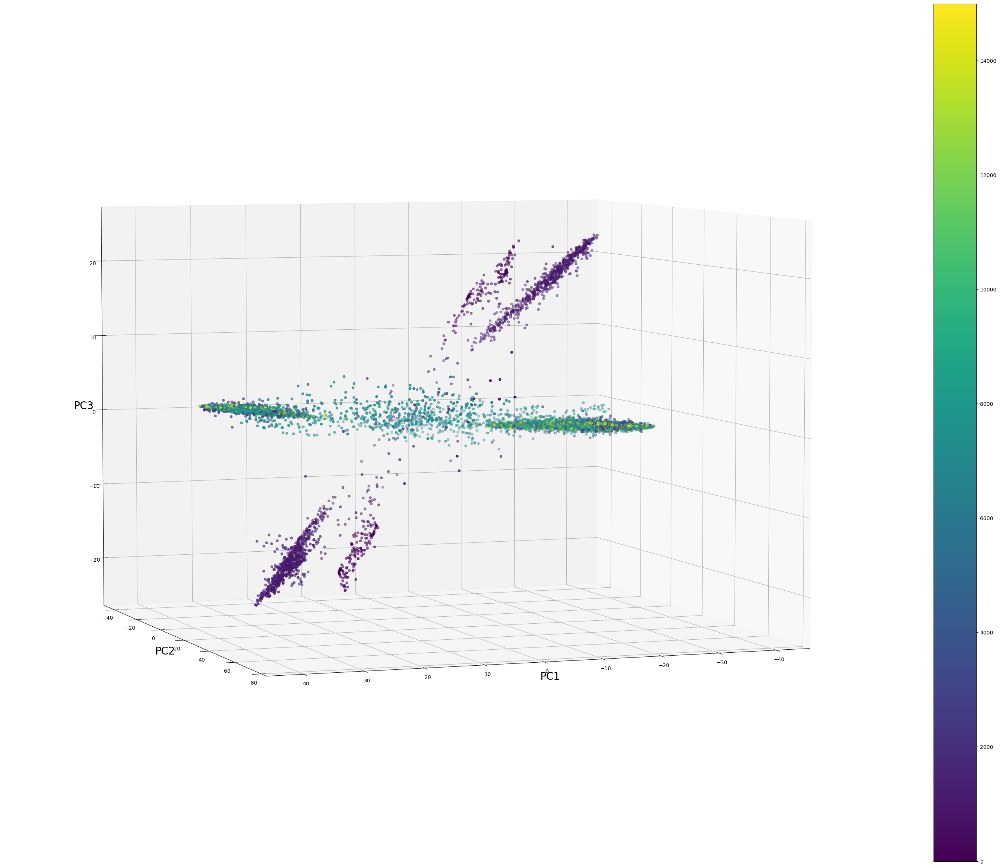

In [9]:
%matplotlib inline
fig=plt.figure(figsize=(50,30))#(figsize=(100,100))
# ax1 = Axes3D(fig)
ax1=fig.add_subplot(projection='3d')
# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=5, azim=70)
#図の設定
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 
bar=ax1.scatter3D(feature[:, 0], feature[:, 1], feature[:, 2], c=list(np.arange(len(feature[:, 0]))))
fig.colorbar(bar)
plt.show()

## animation

In [10]:
%matplotlib inline
from matplotlib import animation, rc
from IPython.display import HTML

fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[:i*100, 0], feature[:i*100, 1], feature[:i*100, 2])
    return ln
"""
return ln, 
とするとerror
"""
ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani

In [11]:
%matplotlib inline
from matplotlib import animation, rc
from IPython.display import HTML

fig=plt.figure(figsize=(10,4))#(figsize=(100,100))
ax1 = fig.add_subplot(111, projection='3d')

# 3Dグラフの見る方向の初期値を設定
#ax1.view_init(elev=10, azim=80)

#図の設定
#軸ラベル
ax1.set_xlabel("PC1",fontsize=20)
ax1.set_ylabel("PC2",fontsize=20)  
ax1.set_zlabel("PC3",fontsize=20) 

def animate(i):
    ax1.view_init(elev=30., azim=3.6*i%360)
    ln=ax1.plot(feature[i*150:(i+1)*150, 0], feature[i*150:(i+1)*150, 1], feature[i*150:(i+1)*150, 2], 
                "o", markersize=2)
    return ln

ani = animation.FuncAnimation(fig, animate, init_func=None,
                               frames=100, interval=100, blit=True)  
plt.close()

# JavascriptウィジェットをアニメーションオブジェクトのデフォルトのHTML表現として設定
rc('animation', html='jshtml')
ani